Image is made up from the combination of pixels

Image have height, width and channel 
In RGB= 3 color channel 
IN grayscale= 1 color channel

black = 0 and white =255

# Task

Predict patient have malaria or not. It is binary classification problem 

# Data

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

In [2]:
dataset, dataset_info=tfds.load('malaria', with_info=True, as_supervised=True, shuffle_files=True,split=['train'])

In [4]:
dataset_info

tfds.core.DatasetInfo(
    name='malaria',
    full_name='malaria/1.0.0',
    description="""
    The Malaria dataset contains a total of 27,558 cell images with equal instances
    of parasitized and uninfected cells from the thin blood smear slide images of
    segmented cells.
    """,
    homepage='https://lhncbc.nlm.nih.gov/publication/pub9932',
    data_dir='C:\\Users\\avith\\tensorflow_datasets\\malaria\\1.0.0',
    file_format=tfrecord,
    download_size=Unknown size,
    dataset_size=317.62 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=27558, num_shards=4>,
    },
    citation="""@article{rajaraman2018pre,
      title={Pre-trained convolutional neural networks as feature extractors toward
      improved malaria parasite detection in thi

In [5]:
dataset

{'train': <_PrefetchDataset element_spec={'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None)}>}

In [ ]:
# take one image
for data in dataset['train'].take(1):
    print(data)

{'image': <tf.Tensor: shape=(103, 103, 3), dtype=uint8, numpy=
array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)>, 'label': <tf.Tensor: shape=(), dtype=int64, numpy=1>}


In [ ]:
dataset_eg = tf.data.Dataset.range(10)
dataset_eg = dataset_eg.take(7) # take first 7 value 
print(list(dataset_eg.as_numpy_iterator()))

[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)]


In [12]:
dataset_eg = tf.data.Dataset.range(10)
dataset_eg = dataset_eg.skip(7) # skip first 7 value and take rest 
print(list(dataset_eg.as_numpy_iterator()))

[np.int64(7), np.int64(8), np.int64(9)]


In [23]:
TRAIN_RATIO = 0.6
VAL_RATIO = 0.2
TEST_RATIO = 0.2

dataset = tf.data.Dataset.range(10)
print(list(dataset.as_numpy_iterator()))
DATASET_SIZE=len(dataset)

train_dataset = dataset.take(int(TRAIN_RATIO*DATASET_SIZE))
print(list(train_dataset.as_numpy_iterator()))

val_test_dataset = dataset.skip(int(TRAIN_RATIO*DATASET_SIZE))
val_dataset = val_test_dataset.take((int(VAL_RATIO*DATASET_SIZE)))
print(list(val_dataset.as_numpy_iterator()))


test_dataset = val_test_dataset.skip((int(TEST_RATIO*DATASET_SIZE)))
print(list(test_dataset.as_numpy_iterator()))


[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9)]
[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5)]
[np.int64(6), np.int64(7)]
[np.int64(8), np.int64(9)]


In [3]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

# func to split the data
def splits(dataset,TRAIN_RATIO,VAL_RATIO,TEST_RATIO):
    DATASET_SIZE=len(dataset)

    train_dataset = dataset.take(int(TRAIN_RATIO*DATASET_SIZE))
    val_test_dataset = dataset.skip(int(TRAIN_RATIO*DATASET_SIZE))
    val_dataset = val_test_dataset.take((int(VAL_RATIO*DATASET_SIZE)))
    test_dataset = val_test_dataset.skip((int(TEST_RATIO*DATASET_SIZE)))
    return train_dataset, val_dataset, test_dataset

In [4]:
dataset = tf.data.Dataset.range(10)
train_dataset, val_dataset, test_dataset = splits(dataset, TRAIN_RATIO,VAL_RATIO, TEST_RATIO)
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))



[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7)]
[np.int64(8)]
[np.int64(9)]


In [5]:
dataset, dataset_info=tfds.load('malaria', with_info=True, as_supervised=True, shuffle_files=True,split=['train'])

In [6]:
# dataset is made up of dataset and type
# we need to take only dataset to  dataset[0]
train_dataset, val_dataset, test_dataset = splits(dataset[0], TRAIN_RATIO,VAL_RATIO, TEST_RATIO)
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))

[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), np.int64(1)), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 

In [7]:
dataset

[<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>]

# Data Visualization

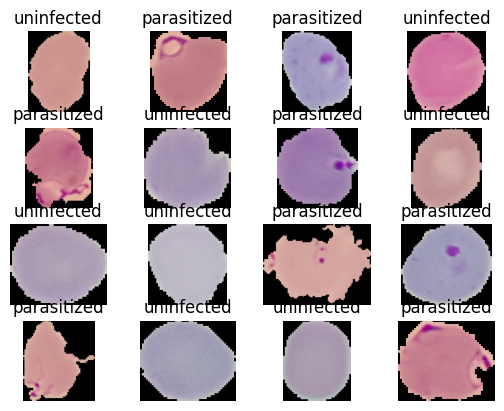

In [8]:
for i, (image, label) in enumerate(train_dataset.take(16)):
    ax=plt.subplot(4,4,i+1)
    plt.imshow(image)
    plt.title(dataset_info.features['label'].int2str(label))
    plt.axis('off')
    

# Data Preprocessing

Images where most of its pixels revolve around a particular mean value then use standardize.

If image is made of pixels where their values are most different from one another, then use normalize. For DL normalization[0-1 or -1 to 1] it best.
Reasons:
- Most deep learning models use ReLU or sigmoid activation functions, which work better with values in a small range (e.g., [0,1] or [-1,1]).
- Avoids large values that can cause vanishing or exploding gradients.
- Reduces computational complexity and speeds up training.

In image, X = (X- Xmin)/(Xmax-Xmin) = X-0/255-0 = X/255


In [9]:
IM_SIZE = 224
# processing on image only
# resize we are making image 244*244
#rescale by normalization
def resizing_rescaling(image, label):
    return tf.image.resize(image, (IM_SIZE, IM_SIZE))/255.0, label

In [10]:
train_dataset = train_dataset.map(resizing_rescaling)

In [11]:
val_dataset= val_dataset.map(resizing_rescaling)
test_dataset=test_dataset.map(resizing_rescaling)

In [12]:
for image, label in train_dataset.take(1):
    print(image,label)

tf.Tensor(
[[[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 ...

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]], shape=(224, 224, 3), dtype=float32) tf.Tensor(1, shape=(), dtype=int64)


In [13]:
train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [14]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [15]:
val_dataset = val_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [16]:
val_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

# ConvNets

In regular fully connected layer each the neuron is connected to all of previous. This increase the total number of parameters considerably.

Now, we need to create NN layer where each neuron is not all connected to all previous neurons. This is Convolution layer

Kernal(filter) reduce the size.

Reduce the kernal size permits us extract more features from the inputs

Weight(W) anf Height(H): to find the size of ouput 
Wout = Win - kernal_size +1
Hout = Hin - kernal_size +1

We want to have particular feature map shape which is not possible just using kernal size then we use padding. We have also another advantage of padding that coner pixel also have an influence on our output features which are generated.

We have stride. This is step you are going to move next.

Now new formula is 

Wo = ((Wi - kernal_size + 2 Padding)/Stride) +1

Pooling layer = filter size and number of strides

Xout = ((Xin - F)/S)+1

max pooling= we pick the max value of them
avg pooling = we pick the avg value of them

After con and pooling, we flaten the ouput and then we do fully connected layers

In [17]:
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dense, Flatten, InputLayer
from tensorflow.keras.layers import BatchNormalization

In [18]:
model = tf.keras.Sequential([
    InputLayer(shape=(IM_SIZE,IM_SIZE,3)),
    Conv2D(filters=6,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Conv2D(filters=16,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Flatten(),
    Dense(100, activation= 'relu'),
    BatchNormalization(),
    Dense(10, activation= 'relu'),
    BatchNormalization(),
    Dense(1, activation= 'sigmoid'),
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,297 (17.81 MB)

 Trainable params: 4,668,033 (17.81 MB)

 Non-trainable params: 264 (1.03 KB)

# Binary Crossentropy Loss

For error sanctioning binary classification problem we generally use Binary Cross entropy loss

-((ylog(p))+(1-y)log(1-p))

We penalized the model if it is prediction value(p) is different from the actual value(y).

Our model now makes use of binary corss entropy loss to update its weights

In [19]:
y_true=[0]
y_pred=[0.8]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.6094379425048828>

In [20]:
y_true=[0]
y_pred=[0]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.1920930376163597e-07>

In [21]:
y_true=[1]
y_pred=[1]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.1920930376163597e-07>

if your value range between zero and one make sure you use default from_logits = False


In [22]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanAbsoluteError, BinaryCrossentropy
from tensorflow.keras.metrics import RootMeanSquaredError


model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = ['accuracy']
)

# Training Convnets

In [23]:
history=model.fit(train_dataset, validation_data=val_dataset, epochs=10, verbose=1)

Epoch 1/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 168s 238ms/step - accuracy: 0.6525 - loss: 0.6216 - val_accuracy: 0.9049 - val_loss: 0.3429
Epoch 2/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 167s 242ms/step - accuracy: 0.8891 - loss: 0.3087 - val_accuracy: 0.8708 - val_loss: 0.5441
Epoch 3/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 172s 249ms/step - accuracy: 0.9193 - loss: 0.2483 - val_accuracy: 0.5205 - val_loss: 14.7578
Epoch 4/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 157s 227ms/step - accuracy: 0.9127 - loss: 0.2666 - val_accuracy: 0.4951 - val_loss: 2.4962
Epoch 5/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 155s 224ms/step - accuracy: 0.9162 - loss: 0.2658 - val_accuracy: 0.4926 - val_loss: 5.2762
Epoch 6/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 153s 222ms/step - accuracy: 0.8704 - loss: 0.3287 - val_accuracy: 0.4904 - val_loss: 0.8479
Epoch 7/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 154s 224ms/step - accuracy: 0.9305 - loss: 0.2242 - val_accuracy: 0.7289 - val_loss: 2.1190
Epoch 8/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 233ms/step - accuracy: 0.9218 

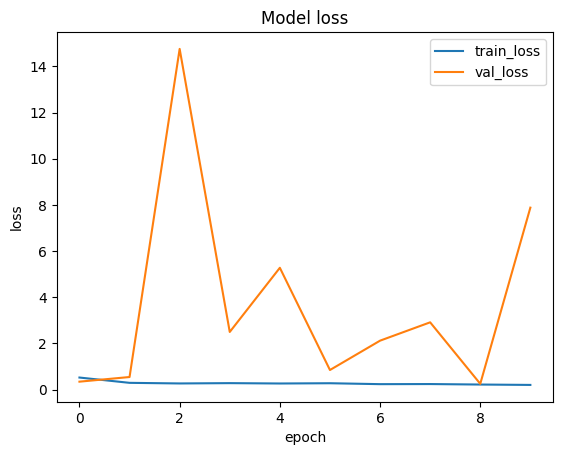

In [24]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train_loss', 'val_loss'])
plt.show()

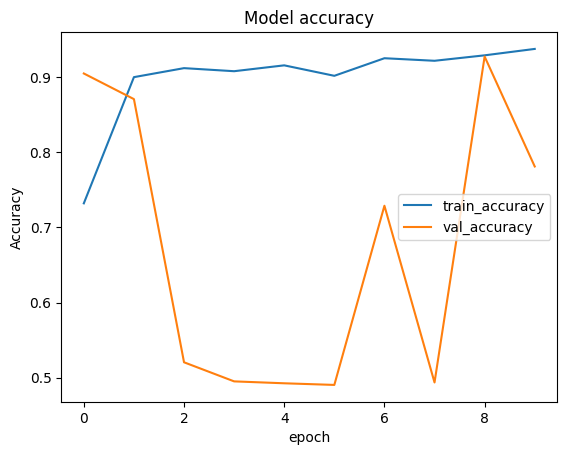

In [25]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['train_accuracy', 'val_accuracy'])
plt.show()

# Validating and Testing 

In [26]:
test_dataset

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [27]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [28]:
test_dataset=test_dataset.batch(1)

In [29]:
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [30]:
model.evaluate(test_dataset)

2757/2757 ━━━━━━━━━━━━━━━━━━━━ 14s 4ms/step - accuracy: 0.8016 - loss: 2.5744


[2.574439287185669, 0.7936162352561951]

In [31]:
model.predict(test_dataset.take(1))[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


np.float32(1.0)

In [32]:
def para_or_not(x):
    if (x<0.5): return str("P")
    else: return str("N")

In [33]:
para_or_not(model.predict(test_dataset.take(1))[0][0])

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


'P'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


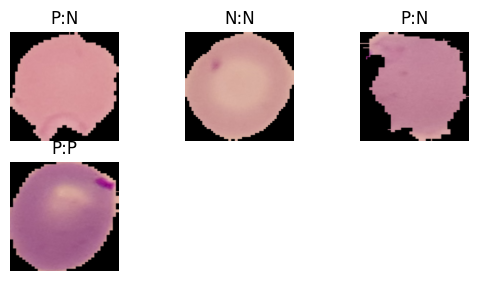

In [34]:
for i, (image, label) in enumerate(test_dataset.take(4)):
    ax=plt.subplot(3,3,i+1)
    plt.imshow(image[0])
    plt.title(str(para_or_not(label.numpy()[0])) + ":" + str(para_or_not(model.predict(image)[0][0])))
    plt.axis('off')
    
    

# Loading and Saving Model

In [ ]:
# Save the model for the next session
# dataset need to be in tensor
model.save("saved_model/malaria_model.keras")
print("Model saved successfully!")

Model saved successfully!


In [39]:
# Load or create a model
try:
    model = tf.keras.models.load_model("saved_model/malaria_model.keras")  # Load if exists
    print("Model loaded successfully!")
except:
    model = create_model()  # Define your model function
    print("New model created!")

# Train for 10 epochs
history=model.fit(train_dataset, validation_data=val_dataset, epochs=10, verbose=1)

# Save the model for the next session
model.save("saved_model/malaria_model.keras")
print("Model saved successfully!")

Model loaded successfully!
Epoch 1/10


c:\Users\avith\anaconda3\envs\cv_dl\lib\site-packages\keras\src\saving\saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 38 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


689/689 ━━━━━━━━━━━━━━━━━━━━ 168s 240ms/step - accuracy: 0.9399 - loss: 0.1996 - val_accuracy: 0.9350 - val_loss: 0.2007
Epoch 2/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 153s 222ms/step - accuracy: 0.9497 - loss: 0.1691 - val_accuracy: 0.9423 - val_loss: 0.2032
Epoch 3/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 155s 225ms/step - accuracy: 0.9562 - loss: 0.1525 - val_accuracy: 0.9238 - val_loss: 0.3075
Epoch 4/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 158s 229ms/step - accuracy: 0.9586 - loss: 0.1399 - val_accuracy: 0.9405 - val_loss: 0.2027
Epoch 5/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 160s 233ms/step - accuracy: 0.9590 - loss: 0.1386 - val_accuracy: 0.4936 - val_loss: 4.6598
Epoch 6/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 234ms/step - accuracy: 0.9292 - loss: 0.2112 - val_accuracy: 0.9459 - val_loss: 0.3015
Epoch 7/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 233ms/step - accuracy: 0.9589 - loss: 0.1397 - val_accuracy: 0.8987 - val_loss: 0.3071
Epoch 8/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 167s 242ms/step - accuracy: 0.9609 - loss: 0.13

# Loading and Saving Models to Google Drive

In [ ]:
drive.mount('/content/drive')

In [ ]:
!cp -r /content/lenet/ /content/drive/MyDrive/model_colab/

In [ ]:
!cp -r /content/drive/Mydrive/model_colab/ /content/model_colab/